In [9]:
# !pip install pandas
# !pip install matplotlib
# !pip install numpy
# !pip install tweepy
# !pip install nltk
# !pip install networkx
# !pip install textblob
# !pip install tensorflow==1.15
# !pip install scikit-learn
# !pip install tensorflow_hub
# !pip install textwrap3
# !pip install plotly
# !pip install vaderSentiment
# !pip install wordcloud

In [10]:
# import essential packages
import pandas as pd
import matplotlib.pyplot as plt
import csv
import json
import numpy as np
import os
import itertools
import collections
import tweepy
import nltk
from nltk.corpus import stopwords
import re
import networkx
from textblob import TextBlob
import pandas as pd
import math
import numpy as np
from nltk.tokenize import word_tokenize
from nltk.tokenize import RegexpTokenizer
from nltk.stem import PorterStemmer
import json
import warnings
from collections import defaultdict
from sklearn.cluster import KMeans
import textwrap
import plotly
import plotly.express as px
import plotly.graph_objects as go
from plotly import tools
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
import matplotlib.cm as cm
from sklearn.cluster import MiniBatchKMeans
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import string
from nltk.tokenize import TweetTokenizer
from nltk.corpus import stopwords
from collections import Counter
warnings.filterwarnings("ignore")
# pd.set_option('display.max_rows', 500)
# pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)
pd.options.display.max_rows
pd.set_option('display.max_colwidth', -1)
# from utils.text_wapper import remove_url

In [ ]:
import tensorflow as tf
import tensorflow_hub as hub

In [11]:
# config data
inputFolder = "./twitter-data-geo-output"

In [12]:
# tweetsText = []
# for file in os.listdir(inputFolder):
#     filePath = "{}/{}".format(inputFolder, file)
#     data = pd.read_json(filePath, orient = 'records', lines = True)

In [14]:
df = None
coronavirus_tweets_folder = "./coronavirus-covid19-tweets"
for dirname, _, filenames in os.walk(coronavirus_tweets_folder):
    for filename in sorted(filenames)[:-2]:
        print(f"processing {filename}")
        filepath = os.path.join(dirname, filename)
        df_file = pd.read_csv(filepath,
                         usecols=["user_id", "text", "lang"]
                        )
        df_file = df_file[df_file["lang"]=="en"]
        if df is None:
            df = df_file
        else:
            df.append(df_file)
        break
        
df.drop(columns='lang', axis=1, inplace=True)
#         if df_ny_tweet_overtime is None:
#             df_ny_tweet_overtime = df
#         else:
#             df_ny_tweet_overtime = pd.concat([df_ny_tweet_overtime, df])

processing 2020-03-00 Coronavirus Tweets (pre 2020-03-12).CSV


In [16]:
df.head()
df.shape

(331552, 2)

In [17]:
# removing URLs
url_pattern = re.compile('http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+')
pic_pattern = re.compile('pic\.twitter\.com/.{10}')
keyword_pattern = re.compile('(covid|-19|_19|\d+)')
df['clean_text'] = df['text'].apply(lambda buf: url_pattern.sub('',buf))
df['clean_text'] = df['clean_text'].apply(lambda buf: pic_pattern.sub('', buf))
df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('@ ', '@'))
df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('# ', '#'))
df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('@', ''))
df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('#', ''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('coronavirus',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('Coronavirus',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('covid19',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('covid-19',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('COVID',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('Covid-19',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('COVID-19',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('COVID19',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('virus',''))
# df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('Covid19',''))
df['clean_text'] = df['clean_text'].apply(lambda buf: buf.replace('\n',''))

df.head()

,user_id,text,clean_text
2,2255210942,China’s wildlife trade via @SCMPgraphics https://t.co/qnLK3n0EBv #2020 #Covid_19 #CoronavirusOutbreak #coronavirus #china #wildlife #market value #overall guide,China’s wildlife trade via SCMPgraphics 2020 Covid_19 CoronavirusOutbreak coronavirus china wildlife market value overall guide
3,366491737,Proof that the media such as @CNN is unnecessary spreading panic and hype regarding the #CoronavirusOutbreak. The Queen has ALWAYS worn gloves -as seen in photo from the #royaltour1947. #insolentFools #beAlertNotanxious #stopSpreadingfear https://t.co/Pl9YRvSWPX,Proof that the media such as CNN is unnecessary spreading panic and hype regarding the CoronavirusOutbreak. The Queen has ALWAYS worn gloves -as seen in photo from the royaltour1947. insolentFools beAlertNotanxious stopSpreadingfear
4,61557732,"Indians are a shitty breed of humans. With the emergency of #CoronavirusOutbreak looming over the country, medical shops are selling masks and sanitizers in black. WTH!!!\n#CoronavirusReachesDelhi","Indians are a shitty breed of humans. With the emergency of CoronavirusOutbreak looming over the country, medical shops are selling masks and sanitizers in black. WTH!!!CoronavirusReachesDelhi"
5,828841083257778176,#CoronavirusOutbreak in India: Techies at #Hyderabad's #Mindspace Asked to Leave After Person Working in The Same Building Tests Positive For #COVID19\n#Telangana #nCoV\nhttps://t.co/QUryXd3FLh,CoronavirusOutbreak in India: Techies at Hyderabad's Mindspace Asked to Leave After Person Working in The Same Building Tests Positive For COVID19Telangana nCoV
6,819488066251423744,"Today’s insightful episode answered the frequently asked questions pertaining to the #CoronavirusOutbreak and dismissed a few myths. @Yunfei_Zh, a Chinese correspondent from @CGTNOfficial reported live from #Wuhan, China and gave us a true sense of the situation on the ground. https://t.co/as1R9LoLam","Today’s insightful episode answered the frequently asked questions pertaining to the CoronavirusOutbreak and dismissed a few myths. Yunfei_Zh, a Chinese correspondent from CGTNOfficial reported live from Wuhan, China and gave us a true sense of the situation on the ground."


In [18]:
df.head()

,user_id,text,clean_text
2,2255210942,China’s wildlife trade via @SCMPgraphics https://t.co/qnLK3n0EBv #2020 #Covid_19 #CoronavirusOutbreak #coronavirus #china #wildlife #market value #overall guide,China’s wildlife trade via SCMPgraphics 2020 Covid_19 CoronavirusOutbreak coronavirus china wildlife market value overall guide
3,366491737,Proof that the media such as @CNN is unnecessary spreading panic and hype regarding the #CoronavirusOutbreak. The Queen has ALWAYS worn gloves -as seen in photo from the #royaltour1947. #insolentFools #beAlertNotanxious #stopSpreadingfear https://t.co/Pl9YRvSWPX,Proof that the media such as CNN is unnecessary spreading panic and hype regarding the CoronavirusOutbreak. The Queen has ALWAYS worn gloves -as seen in photo from the royaltour1947. insolentFools beAlertNotanxious stopSpreadingfear
4,61557732,"Indians are a shitty breed of humans. With the emergency of #CoronavirusOutbreak looming over the country, medical shops are selling masks and sanitizers in black. WTH!!!\n#CoronavirusReachesDelhi","Indians are a shitty breed of humans. With the emergency of CoronavirusOutbreak looming over the country, medical shops are selling masks and sanitizers in black. WTH!!!CoronavirusReachesDelhi"
5,828841083257778176,#CoronavirusOutbreak in India: Techies at #Hyderabad's #Mindspace Asked to Leave After Person Working in The Same Building Tests Positive For #COVID19\n#Telangana #nCoV\nhttps://t.co/QUryXd3FLh,CoronavirusOutbreak in India: Techies at Hyderabad's Mindspace Asked to Leave After Person Working in The Same Building Tests Positive For COVID19Telangana nCoV
6,819488066251423744,"Today’s insightful episode answered the frequently asked questions pertaining to the #CoronavirusOutbreak and dismissed a few myths. @Yunfei_Zh, a Chinese correspondent from @CGTNOfficial reported live from #Wuhan, China and gave us a true sense of the situation on the ground. https://t.co/as1R9LoLam","Today’s insightful episode answered the frequently asked questions pertaining to the CoronavirusOutbreak and dismissed a few myths. Yunfei_Zh, a Chinese correspondent from CGTNOfficial reported live from Wuhan, China and gave us a true sense of the situation on the ground."


In [19]:
df_temp = df.groupby('user_id', as_index=False).agg(sum)

In [20]:
df_temp.head()

,user_id,text,clean_text
0,573,"I wrote this Doc to share a synthesis of my #covid19 reading with family. I went back and forth on whether to share it publicly, but I sent to a few folks today who found it helpful. \n\nLink and intro (which has many caveats) below. Feedback welcome. https://t.co/Msm0UdFCaF https://t.co/jc1Zs8rUvhGoing to add a thread of some of the articles and Twitter threads I've found particularly enlightening. Nearly all were found via this #covid19 Twitter list I have been working on: https://t.co/yTYgyiPYYR\n\nWill add more links to this list as they rise to the top.WHO is moving #COVID19 from epidemic to pandemic as a result of inaction. https://t.co/7XsID7JqrS","I wrote this Doc to share a synthesis of my covid19 reading with family. I went back and forth on whether to share it publicly, but I sent to a few folks today who found it helpful. Link and intro (which has many caveats) below. Feedback welcome. Going to add a thread of some of the articles and Twitter threads I've found particularly enlightening. Nearly all were found via this covid19 Twitter list I have been working on: Will add more links to this list as they rise to the top.WHO is moving COVID19 from epidemic to pandemic as a result of inaction."
1,577,The irony of the UK government being cavalier about the Coronavirus outbreak only for Health Minister Nadine Dorries to test positive for the virus isn’t lost on me. #COVID19,The irony of the UK government being cavalier about the Coronavirus outbreak only for Health Minister Nadine Dorries to test positive for the virus isn’t lost on me. COVID19
2,581,#remoteworking works brilliantly until your kids schools get shut down for #covid19 #ucla #geffenacademy,remoteworking works brilliantly until your kids schools get shut down for covid19 ucla geffenacademy
3,591,#COVID19 management in China https://t.co/xavYo3IxFgSome official movement on the #COVID19 front in India. https://t.co/MMcZstEzlqIt's officially a pandemic. #COVID19 https://t.co/RiKCrEHzuyItaly &amp; #COVID19 https://t.co/6eROGYQe5w,COVID19 management in China Some official movement on the COVID19 front in India. It's officially a pandemic. COVID19 Italy &amp; COVID19
4,977,@mike_deeks @televisionarie here are some (lengthy) thoughts about working from home/remote during the #COVID19 situation (and beyond).,mike_deeks televisionarie here are some (lengthy) thoughts about working from home/remote during the COVID19 situation (and beyond).


In [21]:
print(df_temp['clean_text'][:100].to_string(index=False))

 I wrote this Doc to share a synthesis of my covid19 reading with family. I went back and forth on whether to share it publicly, but I sent to a few folks today who found it helpful. Link and intro (which has many caveats) below. Feedback welcome.  Going to add a thread of some of the articles and Twitter threads I've found particularly enlightening. Nearly all were found via this covid19 Twitter list I have been working on: Will add more links to this list as they rise to the top.WHO is moving COVID19 from epidemic to pandemic as a result of inaction.                                                                                                                                                                                                                                                                                                                                                                                                                                                          

In [1]:
inputFolder = "./basilisk-master/out/"
safe_words_file = inputFolder + "SAFE-HS-diffScore.lexicon"
hazard_words_file = inputFolder + "HAZARD-HS-diffScore.lexicon"
tokenizer = TweetTokenizer()
punct = list(string.punctuation)
stopwords_additional = ['coronavirus', 'covid19', 'covid-19', 'covid', 'covid_19', '19', 'corona']
stopwords_list = stopwords.words('english') + punct + ['rt','via','...','…','’','—','—:','“'] + stopwords_additional
print(stopwords_list)


def read_words(infile):
    words = []
    with open(infile, encoding='utf8') as f:
        for line in f.readlines():
            words.append(line.strip())
    return words

stress_words = read_words(inputFolder + "STRESSED-HS-diffScore.lexicon")            
non_stress_words = read_words(inputFolder + "NOT_STRESSED-HS-diffScore.lexicon")

# safe_words = read_words(safe_words_file)            
# hazard_words = read_words(hazard_words_file)

def process_tweets(text, f): 
    count_safe = 0
    count_hazard = 0
    text = text.lower()
    tokens = tokenizer.tokenize(text)
    tokens = [tok for tok in tokens if tok not in stopwords_list and not tok.isdigit()]
#     for tok in tokens:
#         if tok in safe_words:
#             count_safe +=1
#         if tok in hazard_words:
#             count_hazard +=1
#     f.write(' '.join([str(elem) for elem in tokens]) + "\n")
    print(tokens)
    return count_safe, count_hazard

def process_tweets_safe(text): 
    count_safe = 0
    count_hazard = 0
    text = text.lower()
    tokens = tokenizer.tokenize(text)
    for tok in tokens:
        if tok in safe_words:
            count_safe +=1
    return count_safe

def process_tweets_hazard(text): 
    count_safe = 0
    count_hazard = 0
    text = text.lower()
    tokens = tokenizer.tokenize(text)
    for tok in tokens:
        if tok in hazard_words:
            count_hazard +=1
    return count_hazard

# for text in df_temp['clean_text'][:100]:
# #     text = text.to_string(index=False)
#     count_safe, count_hazard = process_tweets(text)
# #     print("Safe count: {0}, Hazard count: {1}".format(count_safe, count_hazard))
    
# df_temp["count_safe"] = df_temp.clean_text.map(lambda x:process_tweets_safe(x))
# df_temp["count_hazard"] = df_temp.clean_text.map(lambda x:process_tweets_hazard(x))

# df_kmeans1 = df_temp[["count_safe","count_hazard"]]
# df_kmeans1.head()
# keyword_count_array = np.array(df_kmeans1)
# # px.scatter(df, x="Sentiment", y="Subjectivity",color="cluster_sentiment")
# n_cluster = 5
# pred = KMeans(n_clusters=n_cluster).fit_predict(keyword_count_array)

# # df_temp[['clean_text', 'count_safe', 'count_hazard']].head()
# df_temp["cluster_keyword_count"] = pred
# df_temp.head()


NameError: name 'TweetTokenizer' is not defined

In [35]:
with open('tweets.txt', 'w', encoding="utf8") as f:
    df_temp.clean_text.map(lambda x:process_tweets(x, f))


In [43]:
process_tweets("I am coronavirus, I love the virus.", 0)

['9virus', 'love', 'virus']


(0, 0)

In [ ]:
px.scatter(df_temp, x="count_safe", y="count_hazard",color="cluster_keyword_count", hover_data=["text"])

In [12]:
## Tweet term frequency using TweetTokenizer
tweets_df = df_temp

tweet_tokenizer = TweetTokenizer()
punct = list(string.punctuation)
stopwords_list = stopwords.words('english') + punct + ['rt','via','...','…','’','—','—:','“']
term_frequency = Counter()

def process_tweets_tokens(text, tokenizer=TweetTokenizer(), stopwords = stopwords_list):
    """ Process the text of a tweet
        - Lowercase
        - Tokenize
        - Stopword removal
        - Digits removal """    
    text = text.lower()
    tokens = tokenizer.tokenize(text)
    return([tok for tok in tokens if tok not in stopwords and not tok.isdigit()])

def process_tweets(x):
    twtokens = process_tweets_tokens(x, tokenizer = tweet_tokenizer, stopwords= stopwords_list)
    return(' '.join(twtokens))

for x in tweets_df.clean_text:
    tweet_tokens = process_tweets_tokens(x, tokenizer = tweet_tokenizer, stopwords= stopwords_list)
    term_frequency.update(tweet_tokens)

for tag, count in term_frequency.most_common(20):
    print("{}: {}".format(tag, count))

tweets_df['processed_tweets'] = tweets_df['clean_text'].apply(process_tweets)

tweets_df[['text', 'clean_text', 'processed_tweets']].head()

## 6) WordCloud for most occuring words

from collections import Counter 
# wordcloud in python
from wordcloud import WordCloud, STOPWORDS 

import re 
import string
import nltk # preprocessing text
from textblob import TextBlob

wordcloud = WordCloud(width=1600, height=800, random_state=1, max_words=100,colormap="Paired", background_color='black',)
wordcloud.generate(str(tweets_df['processed_tweets']))
# declare our figure 
plt.figure(figsize=(20,10))
plt.title("Top words - tweets", fontsize=20,color='black')
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.tight_layout(pad=10)
plt.show()

covid: 121643
_19: 115364
pandemic: 102848
people: 76958
curfew: 32039
us: 29414
stay: 26531
home: 26405
support: 25156
cases: 24661
”: 24206
time: 23527
get: 22564
need: 22088
please: 21669
like: 21624
italy: 20821
one: 20180
janta: 20089
fight: 20009


ModuleNotFoundError: No module named 'wordcloud'

In [ ]:
tweets_df[['text', 'clean_text', 'processed_tweets']].head()

In [ ]:
## Import the data and create a dict with tweets of a user

# tweetsText = []

# user_tweets = defaultdict(str)
# for file in os.listdir(inputFolder):
#     filePath = "{}/{}".format(inputFolder, file)
#     with open(filePath, "r") as jsonFile:
#         jsf = json.load(jsonFile)
#         for j in jsf:
#             if j['lang'] == 'en':
#                 text = j['text']
#                 text = re.sub(r'http\S+', '', text)
# #                 re.sub(r'^https?:\/\/.*[\r\n]*', '', text)
#                 text.replace('@ ', '@')
#                 text.replace('# ', '#')
#                 tweetsText.append(text)
#                 user_tweets[j['user']['id']] += text
#     break

In [216]:
tfidf = TfidfVectorizer(
    min_df = 5,
    max_df = 0.95,
    max_features = 8000,
    stop_words = 'english'
)


def find_optimal_clusters(data, max_k):
    iters = range(2, max_k+1, 2)
    
    sse = []
    for k in iters:
        sse.append(MiniBatchKMeans(n_clusters=k, init_size=1024, batch_size=2048, random_state=20).fit(data).inertia_)
        print('Fit {} clusters'.format(k))
        
    f, ax = plt.subplots(1, 1)
    ax.plot(iters, sse, marker='o')
    ax.set_xlabel('Cluster Centers')
    ax.set_xticks(iters)
    ax.set_xticklabels(iters)
    ax.set_ylabel('SSE')
    ax.set_title('SSE by Cluster Center Plot')
    

def plot_tsne_pca(data, labels):
    max_label = max(labels)
    max_items = np.random.choice(range(data.shape[0]), size=3000, replace=False)
    
    pca = PCA(n_components=5).fit_transform(data[max_items,:].todense())
    tsne = TSNE().fit_transform(PCA(n_components=50).fit_transform(data[max_items,:].todense()))
    
    
    idx = np.random.choice(range(pca.shape[0]), size=300, replace=False)
    label_subset = labels[max_items]
    label_subset = [cm.hsv(i/max_label) for i in label_subset[idx]]
    
    f, ax = plt.subplots(1, 2, figsize=(14, 6))
    
    ax[0].scatter(pca[idx, 0], pca[idx, 1], c=label_subset)
    ax[0].set_title('PCA Cluster Plot')
    
    ax[1].scatter(tsne[idx, 0], tsne[idx, 1], c=label_subset)
    ax[1].set_title('TSNE Cluster Plot')
    


def get_top_keywords(data, clusters, labels, n_terms):
    df = pd.DataFrame(data.todense).groupby(clusters).mean()
    
    for i,r in df.iterrows():
        print('\nCluster {}'.format(i))
        print(','.join([labels[t] for t in np.argsort(r)[-n_terms:]]))
            


In [209]:
tfidf.fit(tweets_df.clean_text)
text = tfidf.transform(tweets_df.clean_text)

In [210]:
clusters = MiniBatchKMeans(n_clusters=5, init_size=1024, batch_size=2048, random_state=20).fit_predict(text)

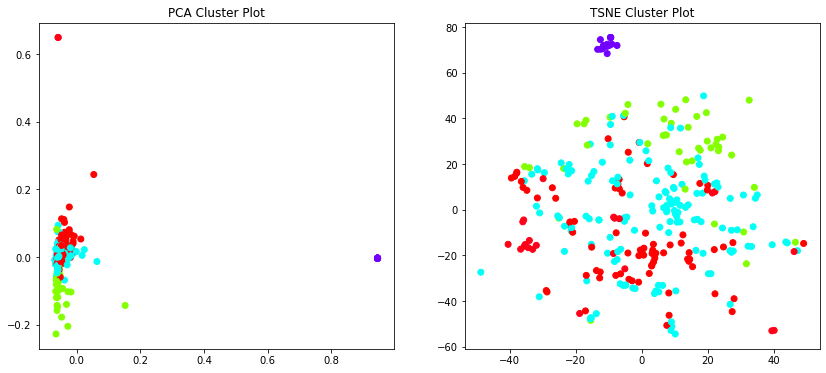

In [211]:
plot_tsne_pca(text, clusters)

In [218]:
get_top_keywords(text, clusters, tfidf.get_feature_names(), 10)

NotFittedError: Vocabulary not fitted or provided

In [67]:
# Get word embedding mod
embed = hub.load("https://tfhub.dev/google/universal-sentence-encoder/4")

In [144]:
data = df_temp['text'].tolist()
chunks = [data[x:x+10000] for x in range(0, len(data), 10000)]
len(chunks)
df2 = df_temp.head(10000)

In [145]:
# Get word embeddings
cfg = tf.ConfigProto(allow_soft_placement=True )
cfg.gpu_options.allow_growth = True
with tf.Session(config=cfg) as session:
    session.run([tf.global_variables_initializer(), tf.tables_initializer()])
    message_embeddings = session.run(embed(chunks[0]))
#     message_embeddings = session.run(embed(list(user_tweets.values())))
print(message_embeddings.shape)

(10000, 512)


In [11]:
# Bert

# from bert_serving.client import BertClient
# client = BertClient()
# vectors = client.encode(user_tweets_text)
# print(len(vectors))

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters
Fit 32 clusters
Fit 34 clusters
Fit 36 clusters
Fit 38 clusters
Fit 40 clusters
Fit 42 clusters
Fit 44 clusters
Fit 46 clusters
Fit 48 clusters
Fit 50 clusters


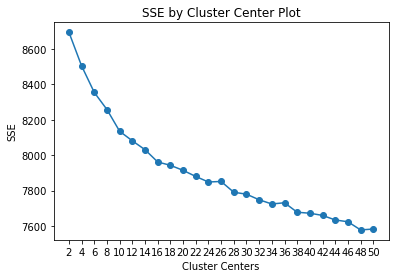

In [154]:
find_optimal_clusters(message_embeddings, 50)

In [167]:
#Cluster using word embeddings
X = message_embeddings
cluster_size = 10
kmeans = KMeans(n_clusters=cluster_size, random_state=42).fit(message_embeddings)

# df = pd.DataFrame(zip(list(user_tweets.keys()), list(user_tweets.values()), kmeans.labels_), columns = ['userid', 'text', 'cluster_text'])

# df.head()

# group = defaultdict(list)
# for index, text in enumerate(user_tweets_text):
#     group[kmeans.labels_[index]].append(text)
    
# for cluster_index in group:
#     print(group[cluster_index])
#     print("-----------------------------------------------------------------------------------")


In [168]:
df2["cluster_text"] = kmeans.labels_
df2.head(100)

user_id  \
0   577       
1   749       
2   888       
3   989       
4   1081      
..   ...      
95  608583    
96  609543    
97  610453    
98  610623    
99  610803    

                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                               

In [172]:
def typical_tweets(df):
    for i in range(5):
        wrap_list = textwrap.wrap(df.iloc[i,1], 76)
        print('\n'.join(wrap_list),'\n')


In [171]:
# Assign Cosine Similality to each Cluster Center
def cos_sim(v1, v2):
    return np.dot(v1, v2)/(np.linalg.norm(v1) * np.linalg.norm(v2))

print(len(X))
norm = np.array(np.zeros(len(X)*cluster_size).reshape(len(X), cluster_size))
for i in range(len(X)):
    for j in range(cluster_size):
        norm[i, j] = cos_sim(X[i], kmeans.cluster_centers_[j])
        
grp_df = pd.concat([df2,
                    pd.DataFrame(norm, index=df2.index).rename(columns={0:'sim0', 1:'sim1', 2:'sim2', 3:'sim3', 4:'sim4', 
                                                                        5:'sim5', 6:'sim6', 7:'sim7', 8:'sim8', 9:'sim9'})],
                    axis=1)
# grp_df = pd.DataFrame(norm, message_embeddings).rename(columns={0:'sim0', 1:'sim1', 2:'sim2', 3:'sim3', 4:'sim4'})
# df = pd.DataFrame(list(zip(norm[:], message_embeddings)), columns = ['sim0','sim1','sim2','sim3','sim4', 'text'])

# grp_df = pd.concat([data_president2,
#                     pd.DataFrame(norm, index=data_president2.index).rename(columns={0:'sim0', 1:'sim1', 2:'sim2', 3:'sim3'})],
#                     axis=1)

# Divide tweets data by Cluster

# df_0 = grp_df[grp_df['cluster_text']==0].sort_values('sim0', ascending=False)
# df_1 = grp_df[grp_df['cluster_text']==1].sort_values('sim1', ascending=False)
# df_2 = grp_df[grp_df['cluster_text']==2].sort_values('sim2', ascending=False)
# df_3 = grp_df[grp_df['cluster_text']==3].sort_values('sim3', ascending=False)
# df_4 = grp_df[grp_df['cluster_text']==4].sort_values('sim3', ascending=False)

# grp_df.head()

10000
       user_id                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                                           text  cluster_text  Sentiment  Subjectivity      sim0      sim1      sim2      sim3      sim4      sim5      sim6      sim7      sim8      sim9
276   1143551   Good Morning and happymothersday to you all and your family! .. Give your ma a buzz today

In [176]:
for i in range(cluster_size):
    df_0 = grp_df[grp_df['cluster_text']==i].sort_values('sim'+str(i), ascending=False)
    typical_tweets(df_0)
    print("\n----------------------------------------------------------------------------------------------------------\n")

Good Morning and happymothersday to you all and your family! .. Give your ma
a buzz today!  WereInThisTogether  Covid_19  mary Europe  Pandemic
MothersDay No excuses for MothersDay &amp; time to share some love ... even
if she wrecks your head!!!  happymothersday to our Ma's! mary's &amp;
mammies  Lots of love this morning RTE2fm for keeping me going for Covid_19
this morning! WereInThisTogether and do it for mary!
mothersday2020communityresponseirl with gardainfo assisting comnnuinites
nationally during Covid_19 SocialDistancing QuaratineLife With so much going
on indeed I felt it necessary to have a moment to say I like this song
especially to chill to    ー19 StayAtHome QuaratineLife  19
WereInThisTogether 

Friday to Sunday....it's a steady climb here in Maryland. Please continue to
keep social distancing, wash hands, go to the store only when necessary.
Check in on your elderly neighbors.  Be well 🙏  ー19 SocialDistancingNow
StayAtHome QuaratineLife Yes, how RandPaul ?  ー19 Quaratin

In [160]:
def sentiment_analysis(text):
    analysis = TextBlob(text)
    Sentiment = analysis.sentiment[0]
    return Sentiment
 

def subjectivity_analysis(text):
    analysis = TextBlob(text)
    Subjectivity = analysis.sentiment[1]
    return Subjectivity 

df2["Sentiment"] = df2.text.map(lambda x:sentiment_analysis(x) )
df2["Subjectivity"] = df2.text.map(lambda x:subjectivity_analysis(x) )

# df[["Sentiment","Subjectivity"]].head()
df2.head()

,user_id,text,cluster_text,Sentiment,Subjectivity
0,577,"UK deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home.",1,0.000000,0.000000
1,749,Product idea: Social-distance compatible tandem bicycle 19,4,0.000000,0.000000
2,888,Hydroxychloroquine cardiotoxicity presenting as a rapidly evolving biventricular cardiomyopathy: key diagnostic features and literature review HeartFailure,5,0.000000,1.000000
3,989,"Worth Reading: Some important reads about and the current pandemic. Read to get proper context, and appreciate the gravity of the situation. What do you know about Wuhan? An illustrated guide to Wuhan from an artist heylauragao who divided time between Wuhan and Texas. Finding connection during social distancing. We are less human if we don’t connect. That’s a fact. And that’s why we should all embrace distant socializing. via stanford 19",0,0.058333,0.272917
4,1081,Excellent explainer video on Exponential growth &amp; epidemics by 3blue1brown 19,4,1.000000,1.000000


In [162]:
# typical_tweets(df_0)

Good Morning and happymothersday to you all and your family! .. Give your ma
a buzz today!  WereInThisTogether  Covid_19  mary Europe  Pandemic
MothersDay No excuses for MothersDay &amp; time to share some love ... even
if she wrecks your head!!!  happymothersday to our Ma's! mary's &amp;
mammies  Lots of love this morning RTE2fm for keeping me going for Covid_19
this morning! WereInThisTogether and do it for mary!
mothersday2020communityresponseirl with gardainfo assisting comnnuinites
nationally during Covid_19 SocialDistancing QuaratineLife With so much going
on indeed I felt it necessary to have a moment to say I like this song
especially to chill to    ー19 StayAtHome QuaratineLife  19
WereInThisTogether 

Friday to Sunday....it's a steady climb here in Maryland. Please continue to
keep social distancing, wash hands, go to the store only when necessary.
Check in on your elderly neighbors.  Be well 🙏  ー19 SocialDistancingNow
StayAtHome QuaratineLife Yes, how RandPaul ?  ー19 Quaratin

In [163]:
# typical_tweets(df_1)

Hey EOrtizOspina JoeHasell MaxCRoser   alexismadrigal kissane  Thank you for
the data. Especially around hospitalizations.   It's still very early... but
note that from your data we can glean that 19 is either a) not as drastic as
though or b) we're handling it well.davidparker555 clairlemon You calculate
CFR: deaths vs confirmed cases. Right now that’s hovering around 1%.   The
flu (2017-18): 61k deaths vs... 1.5 to 3.5 million confirmed cases of the
flu.   The IFR is the number of deaths / symptomatic. 41M symptomatic = .14%
Denom. for 19? All tests? = .2%jackgerard The numbers for 19 are crashing.
This is not the pandemic sold us to justify a shutdown.Now that the
apocalyptic 19 pandemic’s core numbers are collapsing.... the narrative is
shifting quickly to... “well, it was all about the burden on hospitals all
along.”  No one will apologize for claiming biblical death rates as
justification of a shutdown. 

BREAKING:  651 lives lost in last 24hrs in Italy.  Total lives lost now
5,4

In [164]:
# typical_tweets(df_2)


We stand by Italy during these trying times. Share your Support for our
Italian friends, They are our colleagues, friends and family. Cari amici,
siamo con voi. 19 WeStandWithItaly 

We stand by Italy during these trying times. Share your Support for our
Italian friends, They are our colleagues, friends and family. Cari amici,
siamo con voi. 19 WeStandWithItaly 

We stand by Italy during these trying times. Share your Support for our
Italian friends, They are our colleagues, friends and family. Cari amici,
siamo con voi. 19 WeStandWithItaly 

We stand by Italy during these trying times. Share your Support for our
Italian friends, They are our colleagues, friends and family. Cari amici,
siamo con voi. 19 WeStandWithItaly 

We stand by Italy during these trying times. Share your Support for our
Italian friends, They are our colleagues, friends and family. Cari amici,
siamo con voi. 19 WeStandWithItaly 



In [165]:
# typical_tweets(df_3)


This is a huge problem and absolutely cannot wait! Not only is PPE essential
to protect our healthcare workers, but also to prevent them from spreading
19 to others! GetMePPE Looking forward to the first Health Policy Journal
Club next week on policy-related to SARS to help put inContext. Hoping to
have a robust discussion on this timely issue! 19 HPJC medtwitter MedEd 

The U.S. has a long history &amp; tradition of ensuring we’re able to vote
even in the most demanding times. With multiple states choosing to postpone
their primaries due to 19, it’s clear we need to take action now so
Americans can access the ballot box this November. The major bill to respond
to 19 that we’re working on now should help every state set up votebymail
&amp; expand earlyvoting, so Americans won’t have to choose between
exercising their constitutional right &amp; their health. ICYMI – Last week,
I joined SenAmyKlobuchar to introduce legislation to help give new
businesses access to capital, no matter wher

In [166]:
# typical_tweets(df_4)

Solidarity with colleagues and friends in Kibera 19 Getting better London
BUT still a long way to go. SocialDistancing 19 Citymapper Tremendous work
by overwhelmed hospitals in Lombardy. 19 Not sure I wanted to read this. 19 

I’m supposed to be prepping for teaching tomorrow. Can’t stay focused. I
told my students we will figure out what’s reasonable together despite the
alterations I made on the syllabus. Anyone else having trouble getting their
mind right for the work week? selfcompassion 19 Yes, sadly the disparities
that exist are being highlighted by 19 

Thinking creatively — and clinically — about -19: MaryBword speaks with
davidkaplanmd about clear communication, virtual solutions, and vulnerable
populations  onhealth  OPINION: Don’t leave the U.S. because you have to.
Leave because of Donald Trump  by ddunsky  19 -19: What you need to know
this weekend — The latest  updates from across the province  19 19ON Bracing
for -19 in a northern health-care hub  by JonSThompson covido

In [104]:
# keywords = ['coronavirus', 'COVID', 'virus', 'corona', 'pandemic', 'quarantine']
# tokenizer = RegexpTokenizer(r'\w+')
# stop_words = set(stopwords.words('english'))
# ps = PorterStemmer()

# def is_relevant(tweet):
#     word_tokens = tokenizer.tokenize(tweet)
#     word_tokens = [word for word in word_tokens if word not in stop_words]
#    # word_tokens = [ps.stem(w) for w in word_tokens]
#     result =  any(elem in word_tokens for elem in keywords)
#     return result

# relevant_tweets = [tweet for tweet in tweetsText if is_relevant(tweet)]

# print(len(relevant_tweets))
# print(len(tweetsText))



NameError: name 'tweetsText' is not defined

In [ ]:
# for tweet in tweetsText:
#     if is_relevant(tweet):   
#         if word in vocab:
#             vocab[word].add(doc_id)
#         else:
#             vocab[word] = set([doc_id])
#     return vocab      
            
# vocab = parser()
# print(len(vocab))
# tweetsText = [tweet for tweet in tweetsText if keywords in tweet]

In [ ]:
# sentiment_objects = [TextBlob(tweet) for tweet in tweetsText]
# sentiment_objects[0].polarity, sentiment_objects[0]

### Sentiment Analysis Using TextBlob

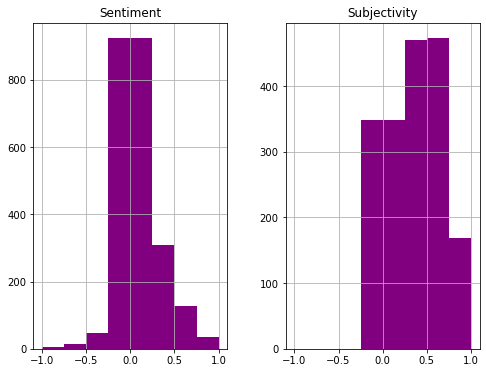

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


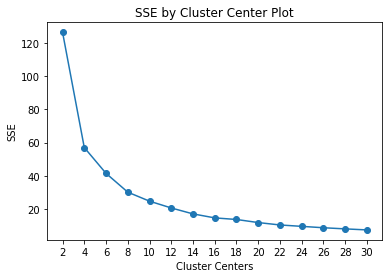

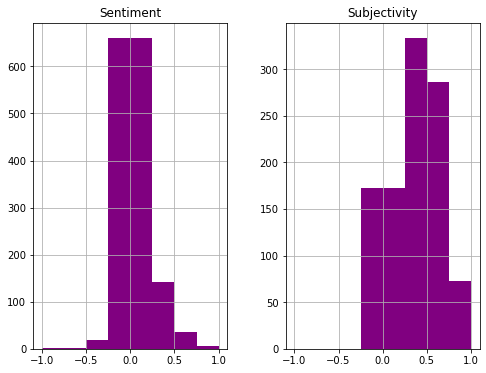

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


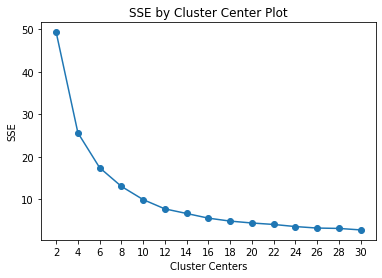

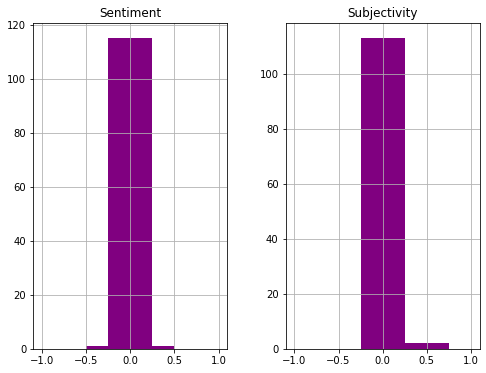

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


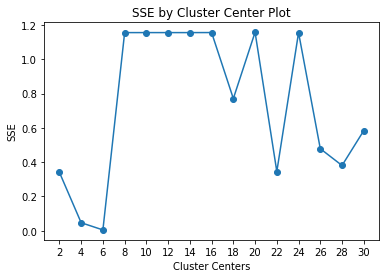

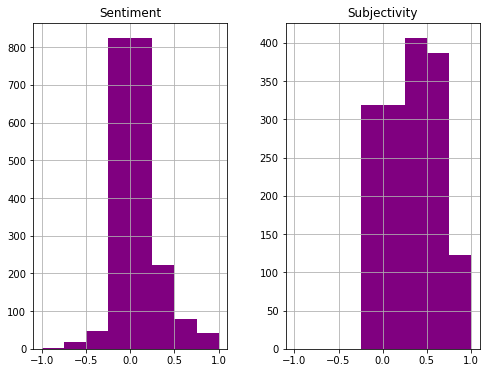

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


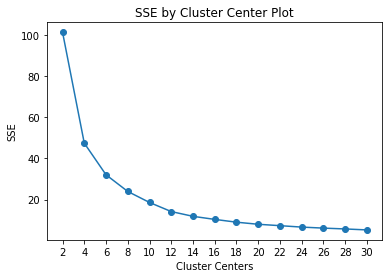

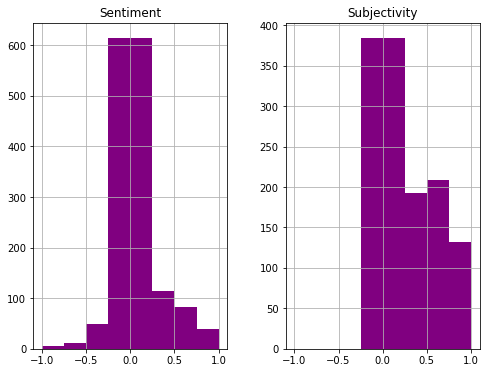

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


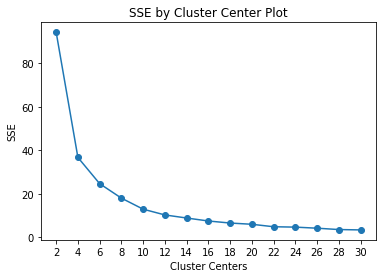

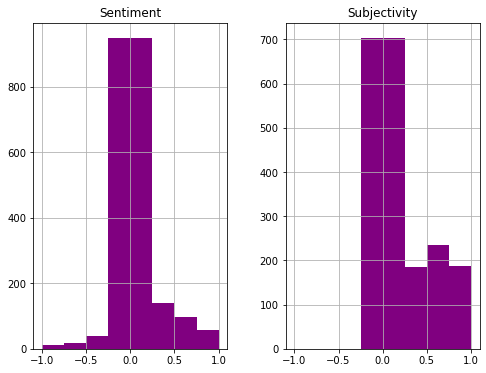

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


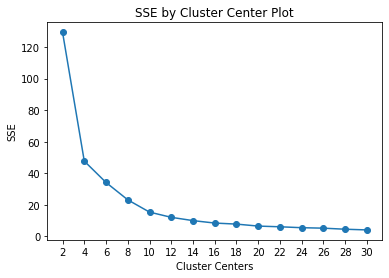

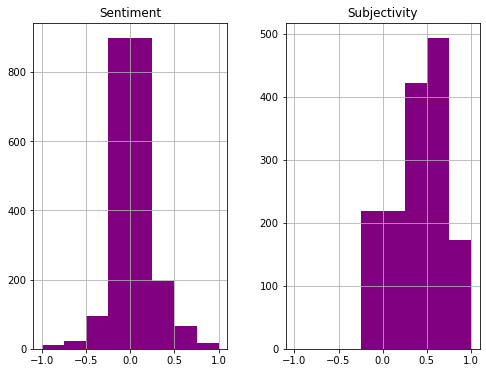

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


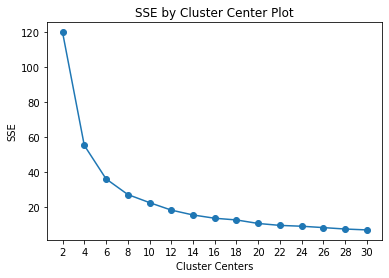

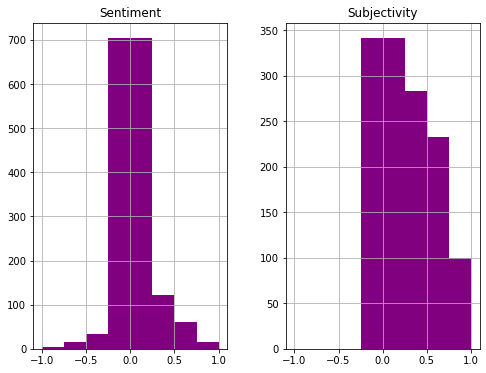

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


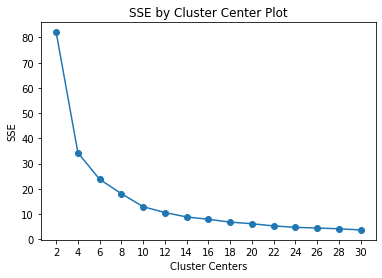

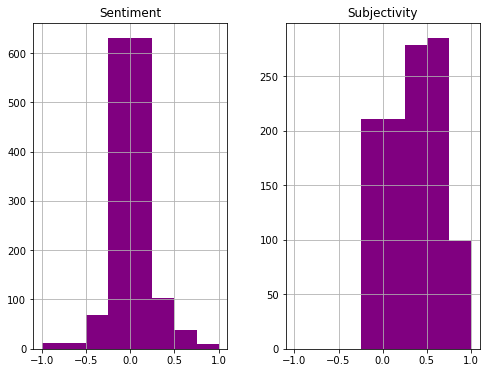

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


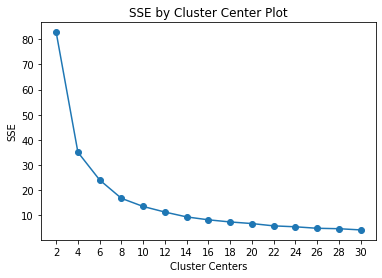

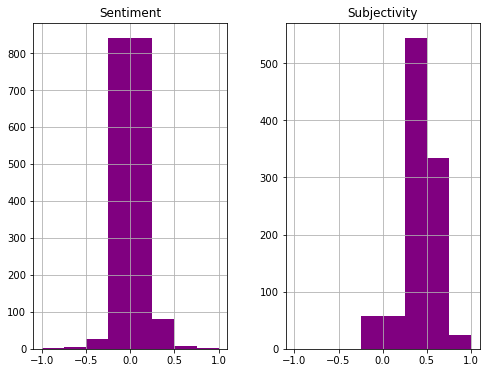

Fit 2 clusters
Fit 4 clusters
Fit 6 clusters
Fit 8 clusters
Fit 10 clusters
Fit 12 clusters
Fit 14 clusters
Fit 16 clusters
Fit 18 clusters
Fit 20 clusters
Fit 22 clusters
Fit 24 clusters
Fit 26 clusters
Fit 28 clusters
Fit 30 clusters


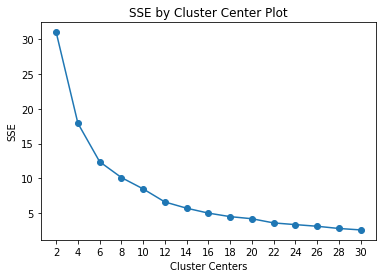

In [178]:
#Sentiment analysis in each cluster grouped by word embeddings

for i in range(0,cluster_size):
    df_grp = df2[df2['cluster_text']==i]
    fig, ax = plt.subplots(figsize=(8, 6))
    df_grp[["Sentiment", "Subjectivity"]].hist(bins=[-1, -0.75, -0.5, -0.25, 0.25, 0.5, 0.75, 1],
             ax=ax,
             color="purple")

#     plt.title("Sentiments from recent Tweets during the COVID period")
    plt.show()
    df_kmeans = df_grp[["Sentiment","Subjectivity"]]
    df_kmeans.head()
    tweets_array = np.array(df_kmeans)
    # px.scatter(df, x="Sentiment", y="Subjectivity",color="cluster_sentiment")
    n_cluster = 5
    

    
    find_optimal_clusters(tweets_array, 30)


    pred = KMeans(n_clusters=n_cluster).fit_predict(tweets_array)
    df_grp["cluster_sentiment_TextBlob"] = pred
    df_grp.head()
    fig = px.scatter(df_grp, x="Sentiment", y="Subjectivity",color="cluster_sentiment_TextBlob", hover_data=["text"])
#     fig = px.scatter(df_grp, x=df_grp.Sentiment, y=df_grp.Subjectivity, color=df_grp.cluster_text)
    fig.show()


# group_count = len(group)
# for i in range(0,group_count):
#     sentiment_objects = [TextBlob(tweet) for tweet in group[i]]
#     sentiment_values = [[tweet.sentiment.polarity, tweet.sentiment.subjectivity, str(tweet)] for tweet in sentiment_objects]
# #     sentiment_df = pd.DataFrame(scores)
#     sentiment_df = pd.DataFrame(sentiment_values, columns=["polarity", "subjectivity", "tweet"])
#     sentiment_df.head()
#     print("\n\n")
#     fig, ax = plt.subplots(figsize=(8, 6))

# # Plot histogram of the polarity values
#     sentiment_df.hist(bins=[-1, -0.75, -0.5, -0.25, 0.25, 0.5, 0.75, 1],
#              ax=ax,
#              color="purple")

#     plt.title("Sentiments from recent Tweets during the COVID period")
#     plt.show()
    
# #     print(sentiment_df[(sentiment_df.polarity > 0.75)])
# #     print(sentiment_df[(sentiment_df.polarity < -0.5)])
    

In [106]:
# !pip install plotly

# px.scatter(sentiment_df.sample(n=3000,  replace=True), x= "polarity", y = "subjectivity")
fig = px.scatter(df2, x=df2.Sentiment, y=df2.Subjectivity, color=df2.cluster_text)
fig.show()

In [108]:
# print(df.head())
df_kmeans = df2[["Sentiment","Subjectivity"]]
df_kmeans.head()
tweets_array = np.array(df_kmeans)
# px.scatter(df, x="Sentiment", y="Subjectivity",color="cluster_sentiment")
n_cluster = 8
pred = KMeans(n_clusters=n_cluster).fit_predict(tweets_array)
df2["cluster_sentiment_TextBlob"] = pred
df2.head()
px.scatter(df2, x="Sentiment", y="Subjectivity",color="cluster_sentiment_TextBlob", hover_data=["text"])


In [112]:
df2.head()

,user_id,text,cluster_text,Sentiment,Subjectivity,cluster_sentiment_TextBlob
0,577,"UK covid19 deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home.",4,0.000000,0.000000,1
1,749,Product idea: Social-distance compatible tandem bicycle COVID19,0,0.000000,0.000000,1
2,888,Hydroxychloroquine cardiotoxicity presenting as a rapidly evolving biventricular cardiomyopathy: key diagnostic features and literature review covid19 HeartFailure,0,0.000000,1.000000,4
3,989,"Worth Reading: Some important reads about Coronavirus and the current pandemic. Read to get proper context, and appreciate the gravity of the situation. coronavirus covid19 What do you know about Wuhan? An illustrated guide to Wuhan from an artist heylauragao who divided time between Wuhan and Texas. covid19 Finding connection during social distancing. We are less human if we don’t connect. That’s a fact. And that’s why we should all embrace distant socializing. via stanford COVID19",3,0.058333,0.272917,6
4,1081,Excellent explainer video on Exponential growth &amp; epidemics by 3blue1brown COVID19,0,1.000000,1.000000,5


In [121]:

df_kmeans = df2[["Sentiment","Subjectivity","cluster_text"]]
df_kmeans.head()
tweets_array = np.array(df_kmeans)
# px.scatter(df, x="Sentiment", y="Subjectivity",color="cluster_sentiment")
n_cluster = 5
# kmeans = KMeans(n_clusters=5, random_state=42).fit(message_embeddings)
# pred = KMeans(n_clusters=n_cluster).fit_predict(tweets_array)
pred = KMeans(n_clusters=n_cluster).fit(tweets_array)

df2["cluster_sentiment_hybrid"] = pred.labels_
df2.head()
fig = px.scatter(df2, x="Sentiment", y="Subjectivity",color="cluster_sentiment_hybrid", hover_data=["text"])

fig.show()
norm = np.array(np.zeros(len(tweets_array)*5).reshape(len(tweets_array), 5))
for i in range(len(tweets_array)):
    for j in range(5):
        norm[i, j] = cos_sim(tweets_array[i], pred.cluster_centers_[j])
        
grp_df = pd.concat([df2,
                    pd.DataFrame(norm, index=df2.index).rename(columns={0:'sim00', 1:'sim11', 2:'sim22', 3:'sim33', 4:'sim44'})],
                    axis=1)
# grp_df = pd.DataFrame(norm, message_embeddings).rename(columns={0:'sim0', 1:'sim1', 2:'sim2', 3:'sim3', 4:'sim4'})
# df = pd.DataFrame(list(zip(norm[:], message_embeddings)), columns = ['sim0','sim1','sim2','sim3','sim4', 'text'])

# grp_df = pd.concat([data_president2,
#                     pd.DataFrame(norm, index=data_president2.index).rename(columns={0:'sim0', 1:'sim1', 2:'sim2', 3:'sim3'})],
#                     axis=1)

# Divide tweets data by Cluster
df_0 = grp_df[grp_df['cluster_sentiment_hybrid']==0].sort_values('sim00', ascending=False)
df_1 = grp_df[grp_df['cluster_sentiment_hybrid']==1].sort_values('sim11', ascending=False)
df_2 = grp_df[grp_df['cluster_sentiment_hybrid']==2].sort_values('sim22', ascending=False)
df_3 = grp_df[grp_df['cluster_sentiment_hybrid']==3].sort_values('sim33', ascending=False)
df_4 = grp_df[grp_df['cluster_sentiment_hybrid']==4].sort_values('sim44', ascending=False)

grp_df.head()

,user_id,text,cluster_text,Sentiment,Subjectivity,cluster_sentiment_TextBlob,cluster_sentiment_hybrid,sim00,sim11,sim22,sim33,sim44
0,577,"UK covid19 deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home.",4,0.000000,0.000000,1,2,0.988106,0.925506,0.993821,-3.600300e-14,0.978128
1,749,Product idea: Social-distance compatible tandem bicycle COVID19,0,0.000000,0.000000,1,3,NaN,NaN,NaN,NaN,NaN
2,888,Hydroxychloroquine cardiotoxicity presenting as a rapidly evolving biventricular cardiomyopathy: key diagnostic features and literature review covid19 HeartFailure,0,0.000000,1.000000,4,3,0.150286,0.351198,0.109222,9.562739e-01,0.207068
3,989,"Worth Reading: Some important reads about Coronavirus and the current pandemic. Read to get proper context, and appreciate the gravity of the situation. coronavirus covid19 What do you know about Wuhan? An illustrated guide to Wuhan from an artist heylauragao who divided time between Wuhan and Texas. covid19 Finding connection during social distancing. We are less human if we don’t connect. That’s a fact. And that’s why we should all embrace distant socializing. via stanford COVID19",3,0.058333,0.272917,6,0,0.998102,0.956084,0.999824,9.228288e-02,0.993061
4,1081,Excellent explainer video on Exponential growth &amp; epidemics by 3blue1brown COVID19,0,1.000000,1.000000,5,3,0.129299,0.348578,0.091196,8.829971e-01,0.160353


In [114]:
df2.head()

,user_id,text,cluster_text,Sentiment,Subjectivity,cluster_sentiment_TextBlob,cluster_sentiment_hybrid
0,577,"UK covid19 deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home.",4,0.000000,0.000000,1,1
1,749,Product idea: Social-distance compatible tandem bicycle COVID19,0,0.000000,0.000000,1,6
2,888,Hydroxychloroquine cardiotoxicity presenting as a rapidly evolving biventricular cardiomyopathy: key diagnostic features and literature review covid19 HeartFailure,0,0.000000,1.000000,4,0
3,989,"Worth Reading: Some important reads about Coronavirus and the current pandemic. Read to get proper context, and appreciate the gravity of the situation. coronavirus covid19 What do you know about Wuhan? An illustrated guide to Wuhan from an artist heylauragao who divided time between Wuhan and Texas. covid19 Finding connection during social distancing. We are less human if we don’t connect. That’s a fact. And that’s why we should all embrace distant socializing. via stanford COVID19",3,0.058333,0.272917,6,2
4,1081,Excellent explainer video on Exponential growth &amp; epidemics by 3blue1brown COVID19,0,1.000000,1.000000,5,0


In [122]:
typical_tweets(df_0)


Homeschooling  For parents thrust into home schooling suddenly - don't
panic. There are heaps of resources online &amp; support. Have fun, use your
child's interests as subject matter. Don't forget this is all new territory
for the kids, too, go gentle on yourselves 💜 coronavirus 

Zigmanfreud People: At Least We’re Safe at Home....   Statistics: Are You?
Me: 🤣  lockdown coronavirus BabyBoomers CoronaCrisis coronavirusitalianews
coronamemes covid19italia stayhealthy stayhome quarantinelife People: At
Least We’re Safe at Home....   Statistics: Are You?   Me: 🤣  lockdown
coronavirus BabyBoomers CoronaCrisis coronavirusitalianews coronamemes
covid19italia stayhealthy stayhome quarantinelife COVIDIOT StayAtHome
QuarantineActivities QuarantineOnlineParty 

jehancicely Behembaba alyciaj09 BreakingBrown You're right! Their income is
tied into their notoriety. Now that coronavirus has leveled the playing
field and they don't have a large media corporation to back them up they
just seem mediocr

In [123]:
typical_tweets(df_1)


"The gift that sisters might provide at the present moment, Sister Marilyn
Lacey, RSM, said, is a sense of calm as well as purpose: calling people,
leveraging institutional resources for people on the ground."  CoronaVirus 

Look at this as an opportunity to show up as an elevated company whose
foundation for decision-making is trust and respect for lives – for honoring
the humans at the end of your decisions.  customerexperience coronavirus
via jeanneblissRandyRainbow brings you a smile with his unique brand of
musical coronavirus comedy. Watch the video and share it widely. 

£115 million, you say? That could cover some of the cost of getting fresh
PPE protection equipment for NHS staff fighting coronavirus. Can’t wait for
the donation, Crispin Odey! Very generous of you!  FA filtering coronavirus
business support information down to clubs. fcbusiness 

State of Vermont vermontgov   has published a map of public wifi hotspots;
super helpful for families looking to connect. NH, not-so

In [124]:
typical_tweets(df_2)


New Coronavirus Can a face mask protect me from coronavirus? Covid-19 myths
busted New Coronavirus A tale for our times: laughter is still the best
medicine | Nancy Banks-Smith New Coronavirus We have a once in a generation
responsibility to confront Covid-19 | Sadiq Khan New Coronavirus How
shopping and Sinatra are helping in coronavirus isolation New Coronavirus
Australia is easing superannuation access for those worst-hit by
coronavirus. But can we afford it? New Coronavirus Britons stranded in Peru
could be flown home early next week New Coronavirus Iran 'frees French
researcher under prisoner exchange deal' New Coronavirus Trump talks himself
up as 'wartime president' to lead America through a crisis New Coronavirus
Coronavirus news updates: concern as Britons defy stay-at-home orders; Italy
tightens lockdown New Coronavirus Doctors warn coronavirus could overwhelm
NHS ‘within weeks’ New Coronavirus NHS would have saved UK woman who died in
Bali of coronavirus, says husband New Co

In [125]:
typical_tweets(df_3)


A flood of new analysis from the CarnegieEndowment on the impact of the
coronavirus around the world: 

NEW UPDATE (REALTIME STATS): curl  CoronaVirus Linux The coronavirus did not
escape from a lab. Here's how we know. 

FDA warns new at-home coronavirus tests are 'unauthorized' - STAT  covid19 

COVID19 Cases in Saskatchewan jump to 52 as eight new cases reported.
COVID19Sask 

Sign up for email updates from New York State on Coronavirus: 



In [126]:
typical_tweets(df_4)


Recent Data For Progress poll on cash payments:  Citizens see both political
parties frittering about as crises caused by this CoronavirusPandemic
intensify. The two-party system is dooming us to more and more pain and
suffering.  Biden campaign has realized they must operate like the Sanders
campaign coronavirus Bernie: I was really stunned to read aspects of
Republican bill that has been proposed. It's not going to go any place. The
Democratic caucus will not accept for a second. coronavirusBernie: We have
Senate Republican bill that would give Trump admin a blank check to hand out
corporate welfare to virtually any corporation in America without
corporations as to how they [should] protect workers. coronavirusBernie
going over vulgar requests from lobbyists. "We're talking about private
space industry - during a pandemic - is requesting $5 billion for Jeff Bezos
and other billionaires." coronavirusBernie: Mars candy bar family want $500
million. coronavirusBernie is saying Trump mus

### Sentiment Analysis Using Vader

In [131]:
# !pip install vaderSentiment
analyser = SentimentIntensityAnalyzer()

scores =[]

def sentiment_analyzer_scores(sentence):
    score = analyser.polarity_scores(sentence)
    print("{:-<40} {}".format(sentence, str(score)))
    
for sentence in df2['text'].tolist():
    score = analyser.polarity_scores(sentence)
    scores.append(score)

# df["Sentiment"] = df.text.map(lambda x:sentiment_analysis(x) )
dataFrame= pd.DataFrame(scores)

print(dataFrame)

print("Overall Sentiment Score for the multiple sentences :- ",dataFrame.mean())

        neg    neu    pos  compound
0     0.167  0.833  0.000 -0.4939  
1     0.000  1.000  0.000  0.0000  
2     0.000  1.000  0.000  0.0000  
3     0.000  0.892  0.108  0.7717  
4     0.000  0.588  0.412  0.7430  
...     ...    ...    ...     ...  
9995  0.000  0.861  0.139  0.2732  
9996  0.050  0.931  0.019 -0.4871  
9997  0.136  0.864  0.000 -0.6249  
9998  0.118  0.819  0.063 -0.8479  
9999  0.149  0.743  0.108 -0.0516  

[10000 rows x 4 columns]
Overall Sentiment Score for the multiple sentences :-  neg         0.073003
neu         0.819071
pos         0.107926
compound    0.120248
dtype: float64


In [132]:
#Cluster using word embeddings


kmeans = KMeans(n_clusters=5, random_state=42).fit(dataFrame.to_numpy())


NameError: name 'dataframe' is not defined

In [133]:
dataFrame["vader_cluster"] = kmeans.labels_
dataFrame['text'] = df2['text']
dataFrame.head()

,neg,neu,pos,compound,vader_cluster,text
0,0.167,0.833,0.000,-0.4939,4,"UK covid19 deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home."
1,0.000,1.000,0.000,0.0000,2,Product idea: Social-distance compatible tandem bicycle COVID19
2,0.000,1.000,0.000,0.0000,2,Hydroxychloroquine cardiotoxicity presenting as a rapidly evolving biventricular cardiomyopathy: key diagnostic features and literature review covid19 HeartFailure
3,0.000,0.892,0.108,0.7717,3,"Worth Reading: Some important reads about Coronavirus and the current pandemic. Read to get proper context, and appreciate the gravity of the situation. coronavirus covid19 What do you know about Wuhan? An illustrated guide to Wuhan from an artist heylauragao who divided time between Wuhan and Texas. covid19 Finding connection during social distancing. We are less human if we don’t connect. That’s a fact. And that’s why we should all embrace distant socializing. via stanford COVID19"
4,0.000,0.588,0.412,0.7430,3,Excellent explainer video on Exponential growth &amp; epidemics by 3blue1brown COVID19


In [136]:
dataFrame.head(100).sort_values('vader_cluster', ascending=False)

,neg,neu,pos,compound,vader_cluster,text
0,0.167,0.833,0.000,-0.4939,4,"UK covid19 deaths up to 281, 48 since yesterday. People infected up to 5,683. Stay at home."
22,0.100,0.900,0.000,-0.2732,4,"Today on ""The Covid-19 Cooking Show"" - How to Cut Up a Squirrel for Cooking - covid19 coronavirus survival game"
85,0.093,0.866,0.041,-0.5106,4,"hollywood take note, this is what you do in a crisis, not sing Imagine CoronavirusPandemic coronavirus COVIDー19 COVIDIOT Trump watch PresidentBernieSanders OurPresidentBernie instead CoronavirusPandemic CoronavirusNewYork COVIDー19 Bernie2020 BernieOrBust2020 StephanieKelton as Secretary of Treasury with PresidentSanders OurPresidentBernie COVIDー19 coronavirus CoronavirusOutbreak Meltdown"
75,0.096,0.831,0.073,-0.1739,4,In show of Solidarity towards victims of CoronaVirus ChineseVirus CCPVirus WuhanCoronavirusOutbreak \n\nI Pledge to never buy anything that is Made in China through out my life!!\n\nBoycottMadeInChina
73,0.140,0.860,0.000,-0.3818,4,"September 19, 2019 - HHS Secretary Azar Statement on Flu Vaccine Executive Order | COVID19 coronavirus justtheflu"
...,...,...,...,...,...,...
42,0.000,0.730,0.270,0.5707,0,"A little JonathanPieNews on Coronavirus, Survival of the Richest! \n\n via YouTube"
46,0.000,0.870,0.130,0.3400,0,What if… all the various sports played out their seasons in video games and streamed live? covid19
49,0.000,0.951,0.049,0.2598,0,"suzannebma, kuomarc Hi! We (at would like to use Routific for planning pickups/deliveries of donated PPE. Chat on your site says you’ll be back on Monday, but I thought I’d try to get your attention sooner, cuz COVID19 doesn’t take weekends."
52,0.000,0.899,0.101,0.4019,0,"Recording FIRpodcast episode 193, the Hobson &amp; Holtz Report for March 2020, with shelholtz. A Coronavirus for communicators special. Show coming on Monday March 23"
